# 1 - Dependencies management

## Theory [2]

As usual, we will start with a few theoretical questions:

* [0.5] What is Docker, and how it differs from dependencies management systems? From virtual machines?

Docker - это платформа для разработки, передачи и развертывания приложений (да и только) в контейнерах. Контейнер - это способ обернуть все необходимое в один пакет, типа код, либы, зависимости, настройки. Это типа своего рода всего необходимого для работы с определенным приложением или выполнения какого то пайплайна: юзеру который скачал готовый контейнер нет необходимости качать какие то прилаги, либы что бы все работало, контейнер уже все содержит, даже может содержать ОС необходимую для работы.

Докер отличается от менеджеров пакетов типа pip, conda - докер управляет не только зависимостями между пакетами, но и всем окружением включая ОС.

В отличие от виртуальных машин, которые эмулируют полные операционные системы, контейнеры используют общее ядро операционной системы хоста, что делает их более легковесными и быстроразворачиваемыми. Контейнеры также потребляют меньше ресурсов, чем виртуальные машины, и обеспечивают более эффективное использование аппаратных ресурсов.

* [0.5] What are the advantages and disadvantages of using containers over other approaches?

Плюсы:

Контейнеры потребляют меньше ресурсов и запускаются быстрее по сравнению с виртуальными машинами, благодаря использованию общего ядра операционной системы. Они включают в себя все зависимости и окружения, все уже содержится в контейнере, остается его скачать и запустить (кроссплатформенность в т/ч). Изолируемость безусловно является плюсом - меньше конфликтов между приложениями и пакетами. Допустим для одного проекта нужен питон 2 для другого питон 3 и тд.

Минусы:

Контейнеры делят ресурсы ядры процессора, что может перегрузить его.

* [0.5] Explain how Docker works: what are Dockerfiles, how are containers created, and how are they run and destroyed?

Докерфайл это по сути инструкция по созданию контейнера, она включает подключение базовых образов, скачивание всяких необходимых файлов, настройки контейнера и тд.

* [0.25] Name and describe at least one Docker competitor (i.e., a tool based on the same containerization technology).

Например Podman - прилага для управления контейнерами в линукс. Представляет с собой альтернативу докер.

* [0.25] What is conda? How it differs from apt, yarn, and others?

Conda - это пакетный менеджер и система управления окружениями для языков программирования, таких как Python, R, Ruby, Lua, Scala, Java и тд. Conda позволяет легко управлять зависимостями, устанавливать и обновлять программное обеспечение, создавать и управлять виртуальными окружениями. Conda является платформенно-независимым пакетным менеджером и может управлять зависимостями для различных операционных систем, включая Windows, macOS и различные дистрибутивы Linux (apt предназначен для дистрибутивов Linux, основанных на Debian; yarn - это пакетный менеджер для JavaScript).

Помимо установки пакетов, Conda позволяет легко создавать, экспортировать, списывать и управлять виртуальными окружениями. Yarn к примеру работает только с зависимостями пакетов JS. Конда к примеру работает с пакетами разных языков программирования, а apt c C/C++ и то ориентирован на работе с линукс, конда кроссплатфоррменна. Опять же yarn для JS.

Конда может качать с нескольких каналов пакеты, включая офф канала, кастомные и др (например bioconda, conda-forge). А вот апт и ярн работают с офф релизами!



## Problem [6.5]

The problem itself is relatively simple.

Imagine that you developed an excellent RNA-seq analysis pipeline and want to share it with the world. Based on your experience, you are confident that the popularity of the pipeline will be proportional to its ease of use. So, you decided to help your future users and to pack all dependencies in a Conda environment and a Docker container.

Here is the list of tools and their versions that are used in your work:
* [fastqc](https://www.bioinformatics.babraham.ac.uk/projects/fastqc/), v0.11.9
* [STAR](https://github.com/alexdobin/STAR), v2.7.10b
* [bcftools](https://github.com/samtools/bcftools), v1.18
* [samtools](https://github.com/samtools/samtools), v1.16.1
* [picard](https://github.com/broadinstitute/picard), v2.27.5
* [salmon](https://github.com/COMBINE-lab/salmon), commit tag 1.9.0
* [bedtools](https://github.com/arq5x/bedtools2), v2.30.0
* [multiqc](https://github.com/ewels/MultiQC), v1.13



**Anaconda**:

* [1] Install conda (or mamba), create a new virtual environment, and install all necessary packages.

Конду скачал с оф сайта, в пакете miniconda!

* [0.5] You won't be able to install some tools - that's fine. List their names, and explain what should be done to make them conda-friendly ([conda-forge](https://conda-forge.org/docs/maintainer/adding_pkgs.html) channel, [bioconda](https://bioconda.github.io/contributor/workflow.html) channel).

Какие то пакеты (все вышеперечисленные) следует качать через bioconda channel, но на самом деле там неявно и conda-forge используется, ибо существуют видимо зависимости которые приходится подгужать из этого канала.

основная команда для загрузки выглядит как: conda install -c bioconda fastqc=0.11.9
* [0.25] Download a genome of some species. Use `fastqc` for it. Calculate basis statistics. Store the results in `fastqc/reports` folder
* [0.25] [Export](https://conda.io/projects/conda/en/latest/user-guide/tasks/manage-environments.html#exporting-the-environment-yml-file) the environment ([example](https://github.com/nf-core/clipseq/blob/master/environment.yml)) to the file and verify that it can be [rebuilt](https://conda.io/projects/conda/en/latest/user-guide/tasks/manage-environments.html#creating-an-environment-from-an-environment-yml-file) from the file without problems.


**Docker**:
* [3] Create a Dockerfile for a container with **all** required dependencies. Don't forget about comments; test that all tools are accessible and work inside the container. Do the same with the download previously genome. Hints:
 - You are not allowed to use conda or conda image here.
 - If needed, grant rights to execute downloaded/compiled binaries using chmod (`chmod a+x BINARY_NAME`)
 - Move all executables to $PATH folders (e.g.`/usr/local/bin`) to make them accessible without specifying the full path.
 - Typical command to run a container interactively (`-it`) and delete on exit(`--rm`): `docker run --rm -it name:tag`
* [1] Use [hadolint](https://hadolint.github.io/hadolint/) and remove as many reported warnings as possible.
* [0.5] Add relevant [labels](https://docs.docker.com/engine/reference/builder/#label), e.g. maintainer, version, etc. ([hint](https://medium.com/@chamilad/lets-make-your-docker-image-better-than-90-of-existing-ones-8b1e5de950d))

# Создаем окружение env

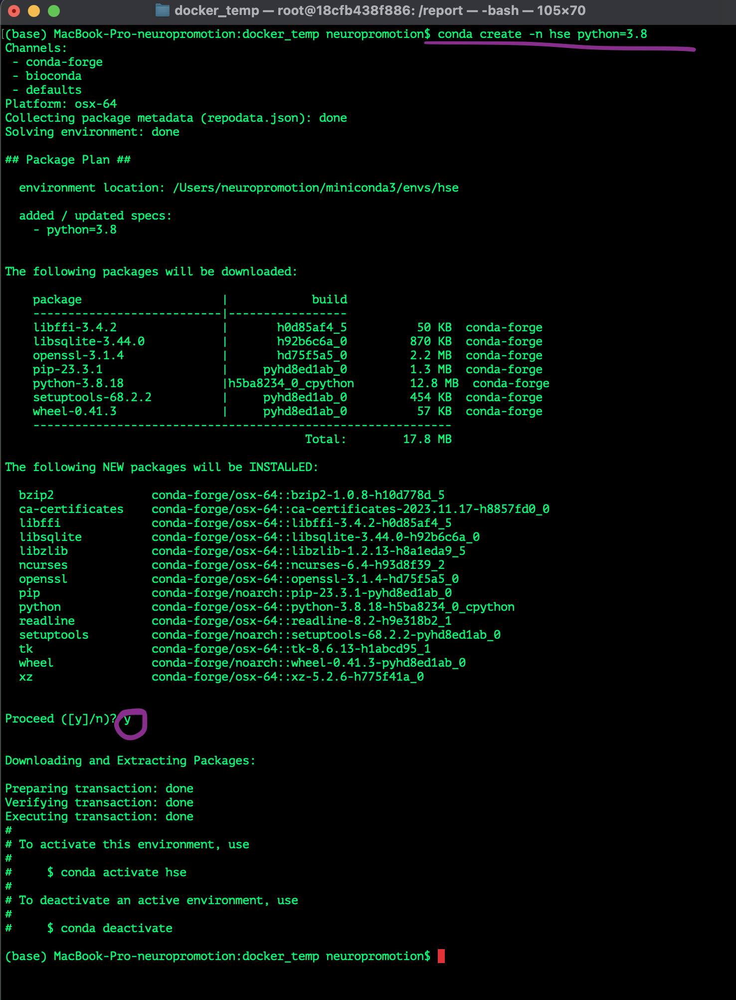

# активируем его:

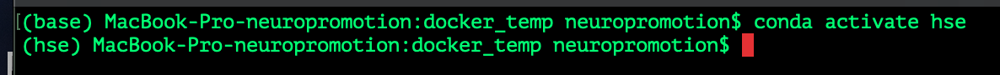

# начинаем качать пакеты:

# FastQC

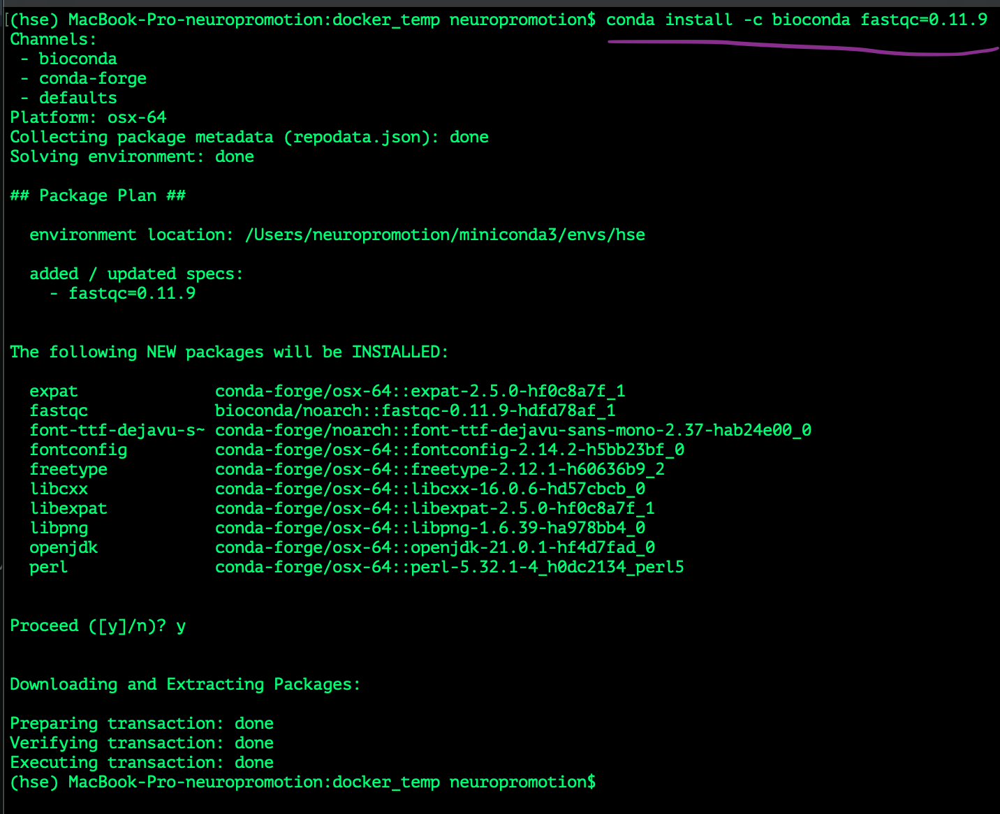

# STAR

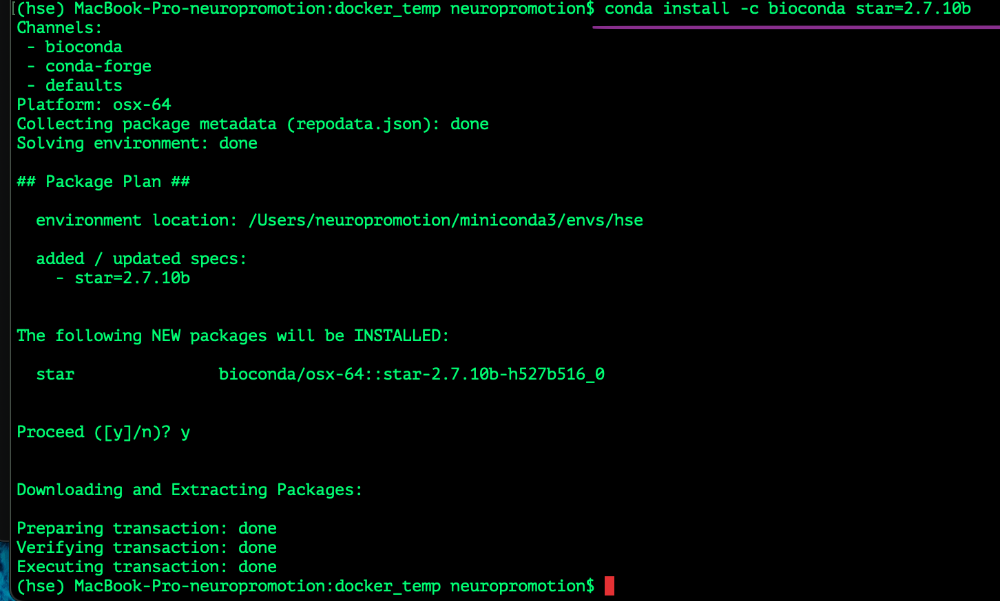

# bcftools требуемой версии (1.18) не установился, как и другие версии. Пришлось просить конду устанавливать без явного указания версии. По описанию возникают какие то внутренние конфликты

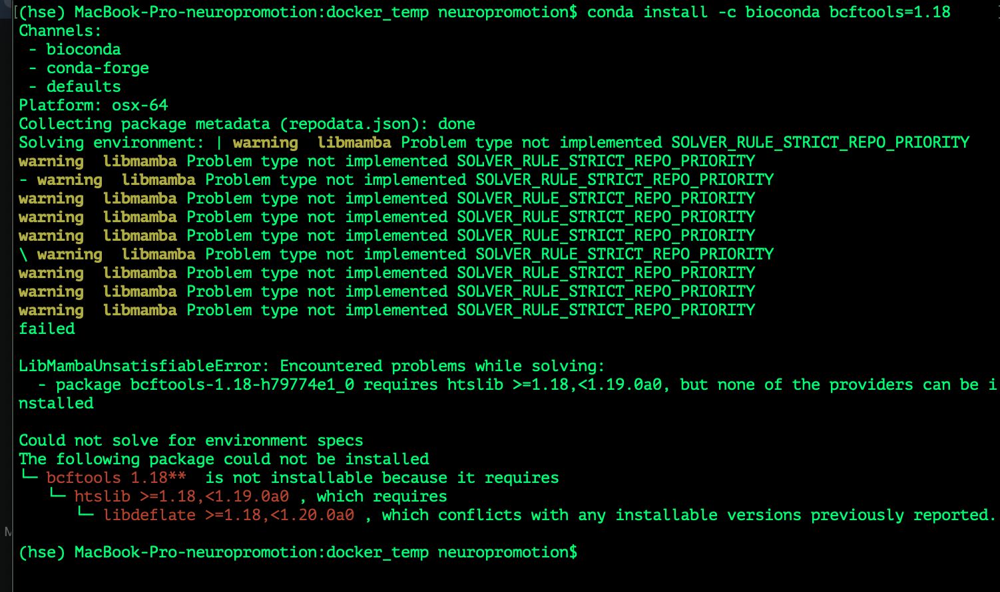

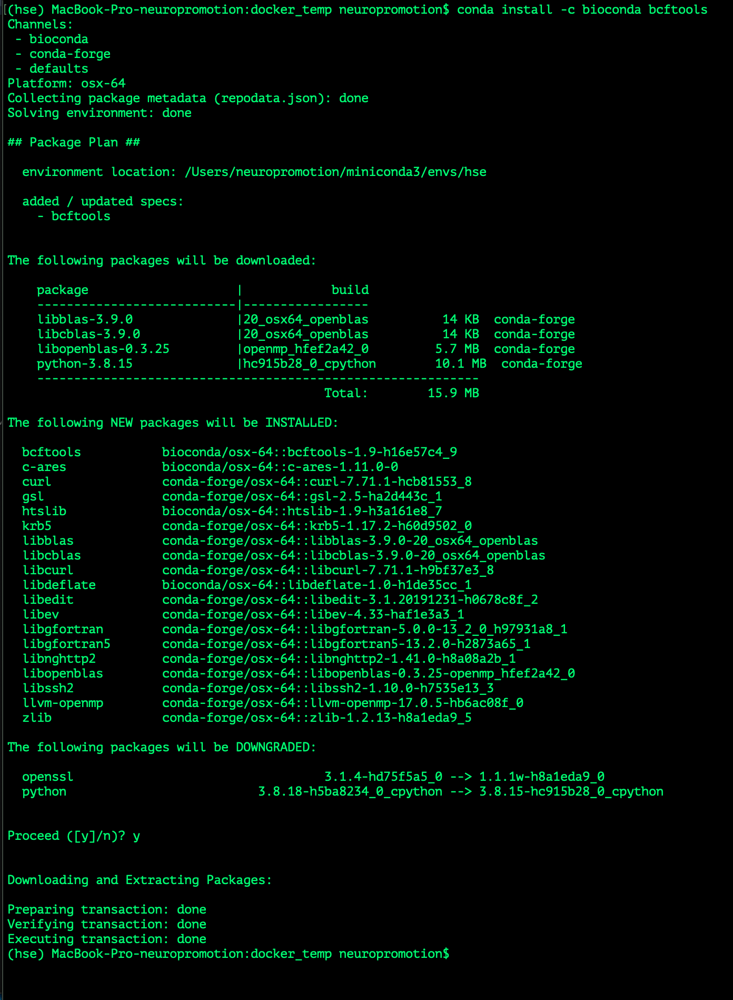

# samtools аналогично, причем версия 1.16 / 1.15 еще больше ошибок выдает

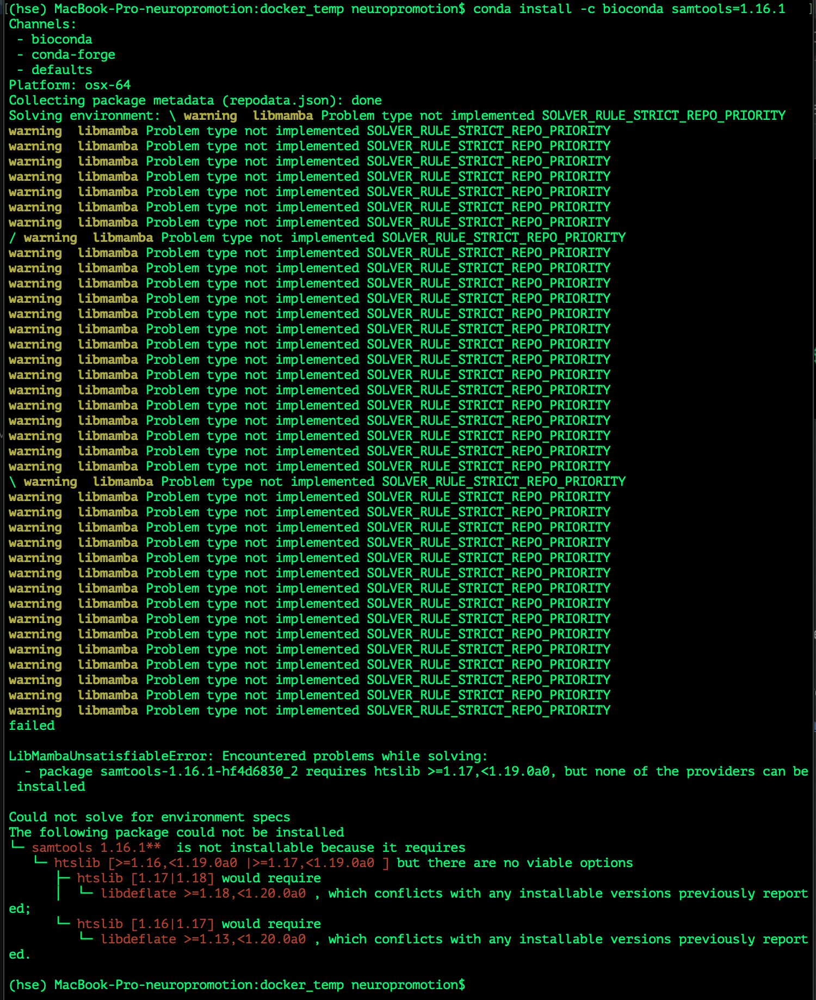

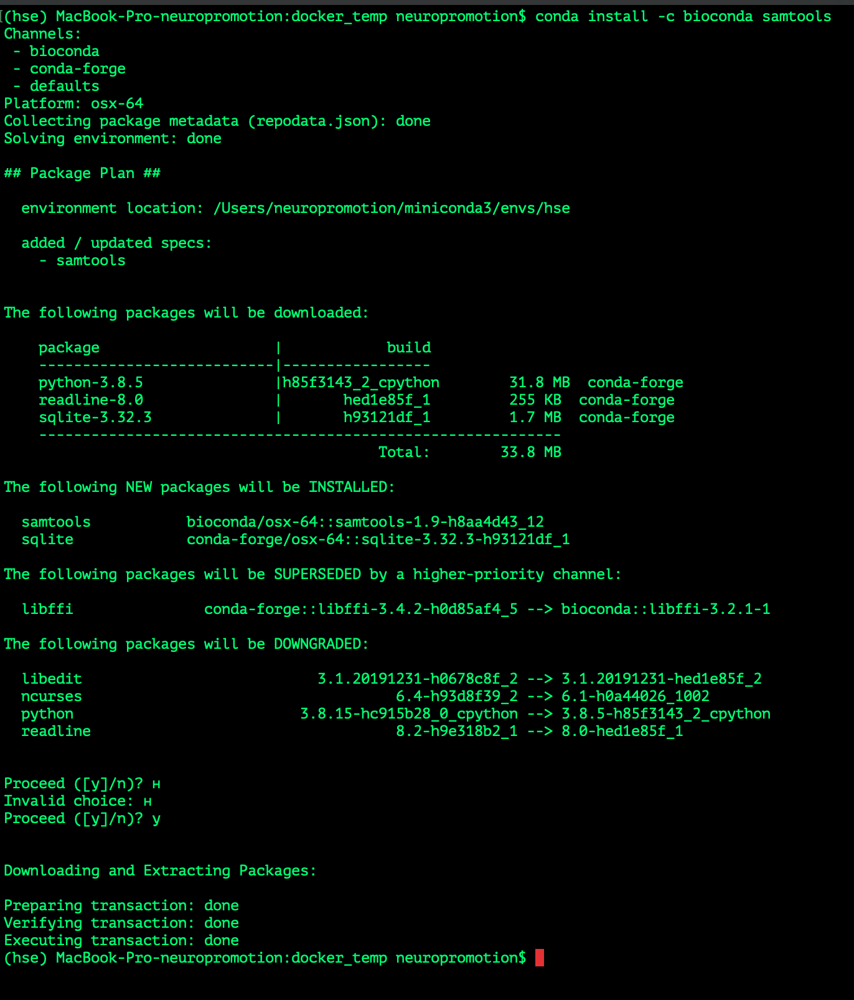

# picard

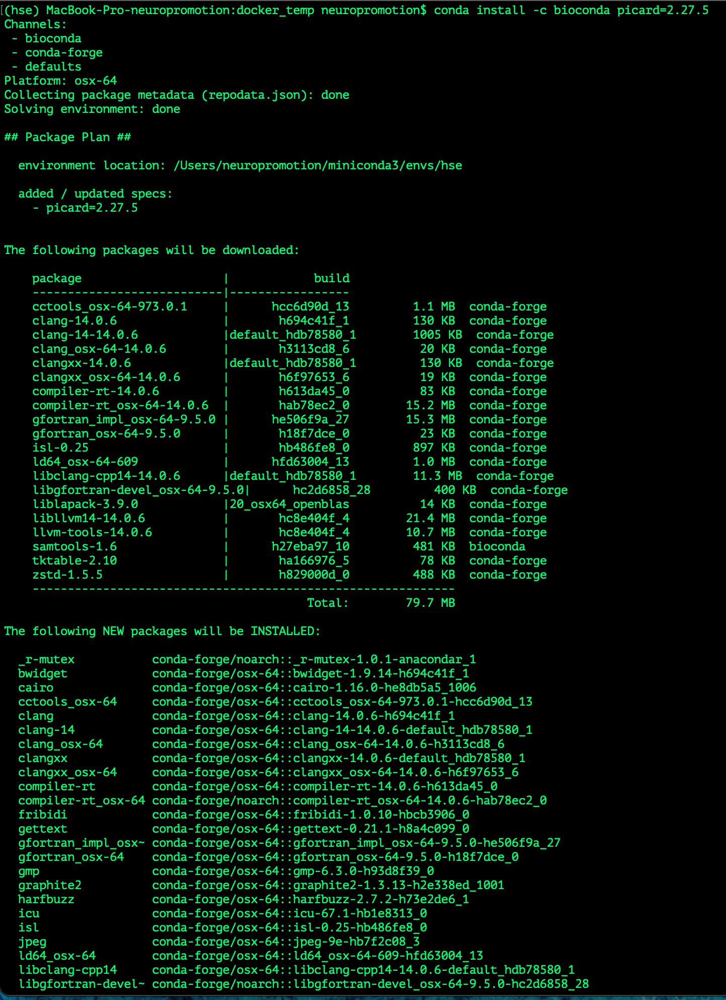

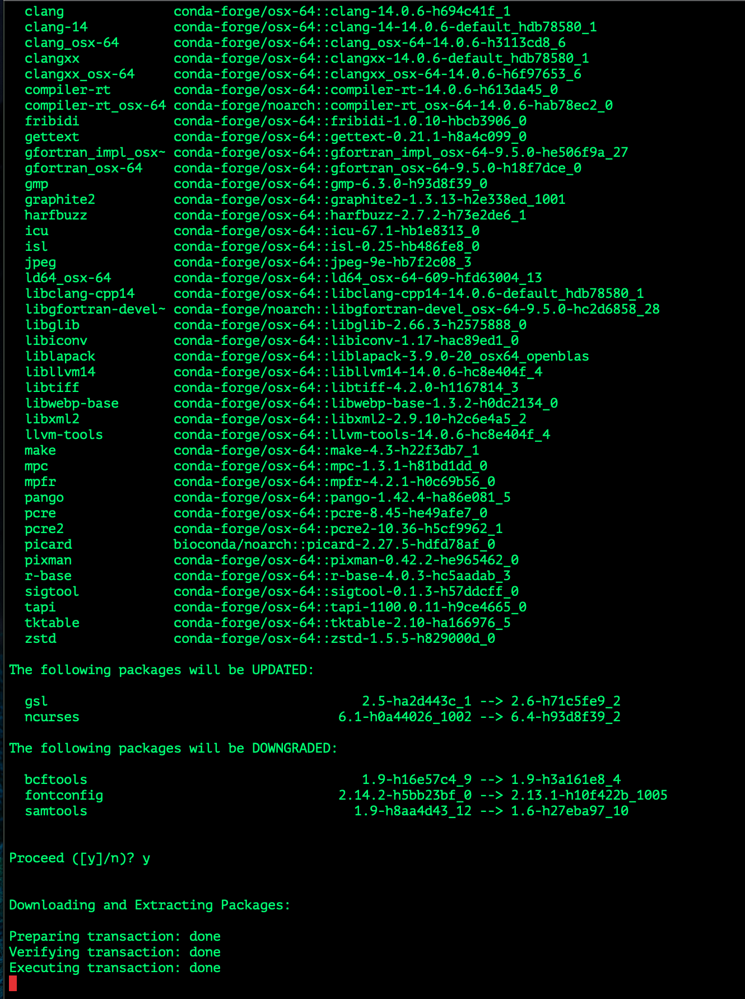

# salmon нужной версии так же не установился:

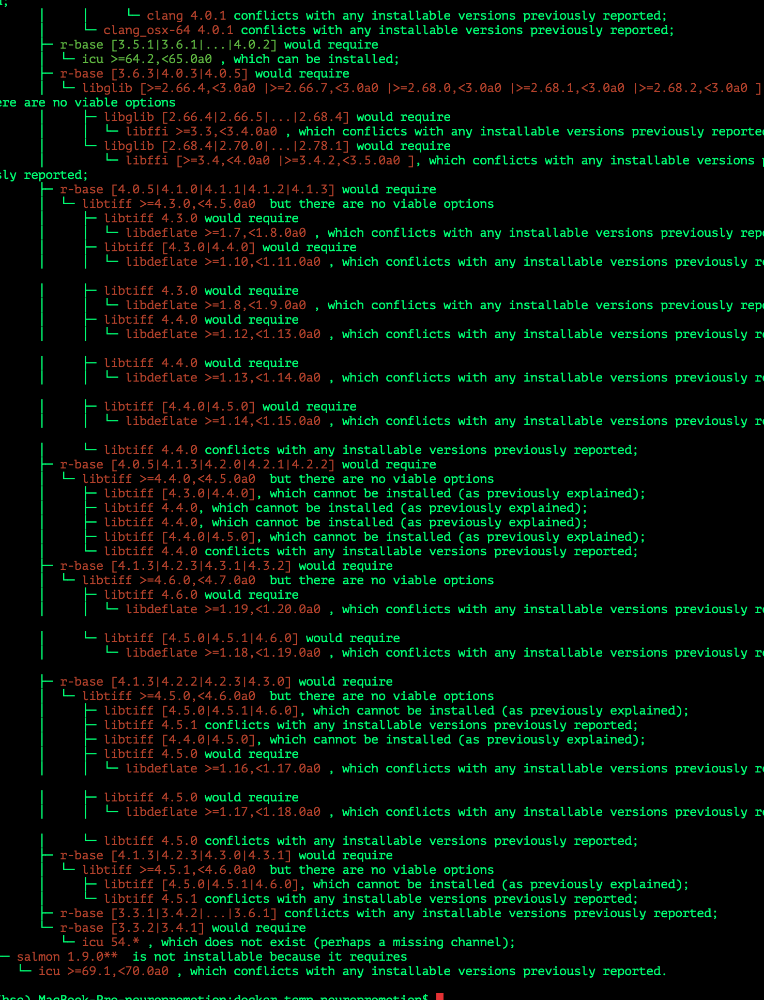

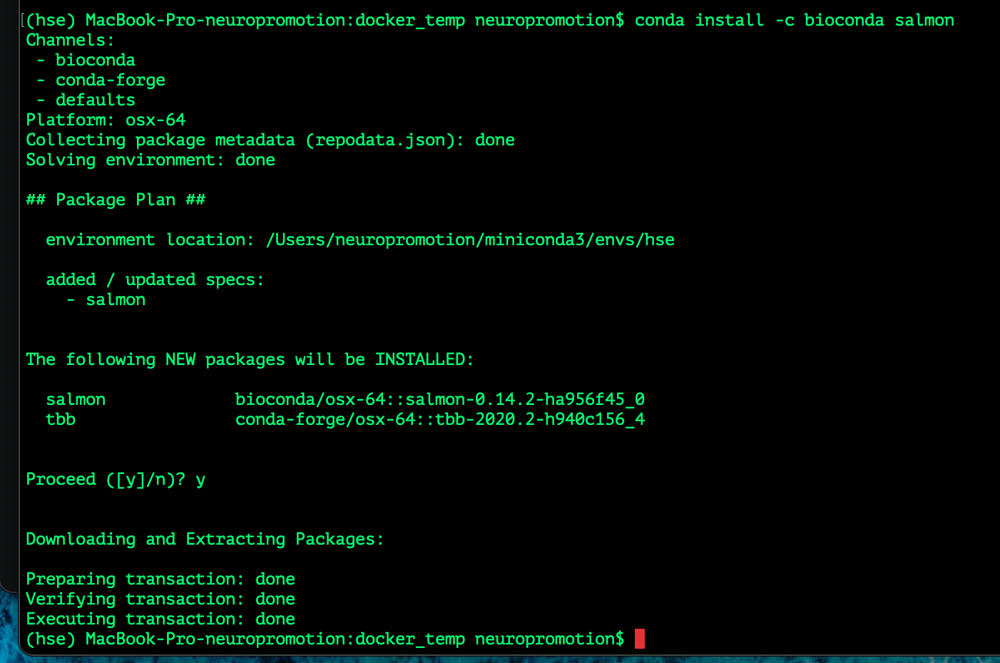

# bedtools:

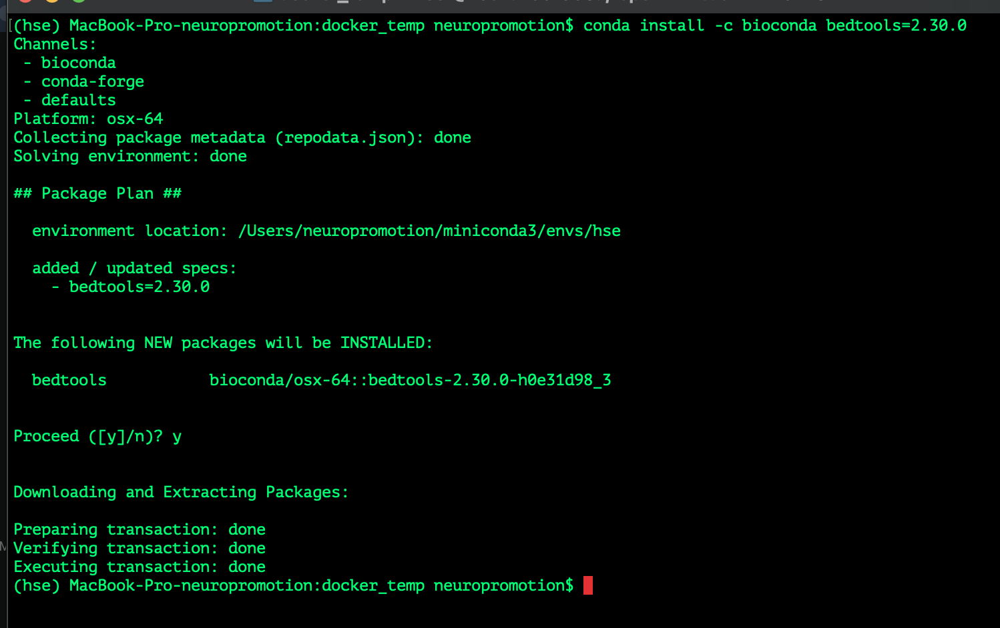

# с multiqc было больше всего проблем, она не устанавливалась даже без версий, чат гпт подсказал что можно попробовать conda install multiqc requests и получилось!

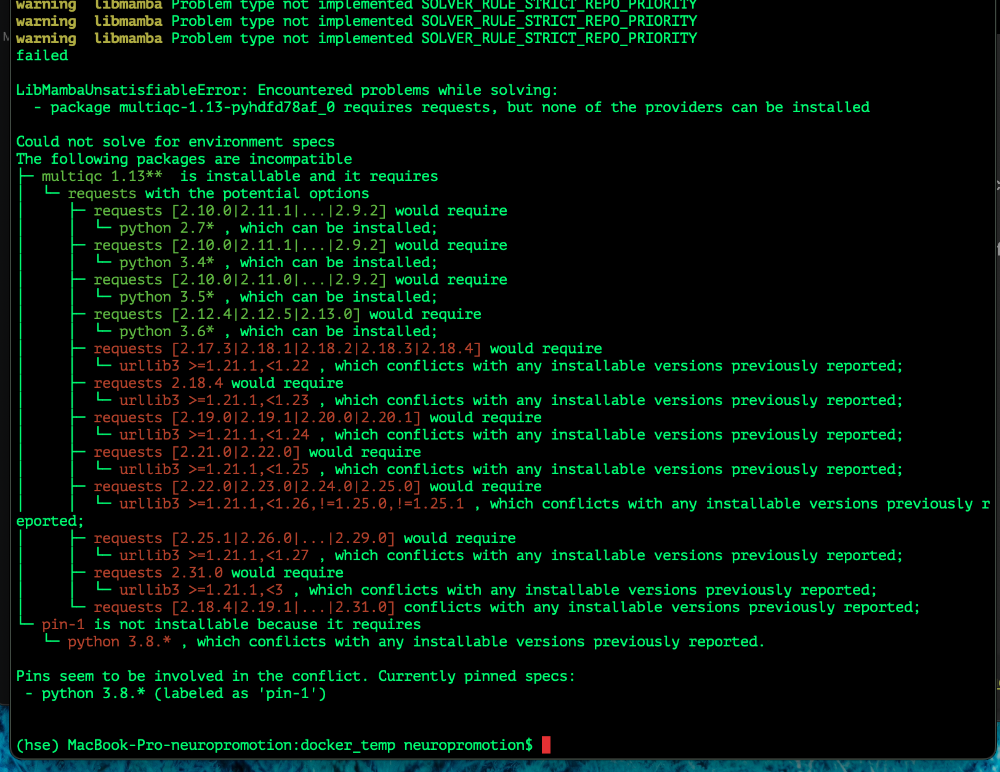

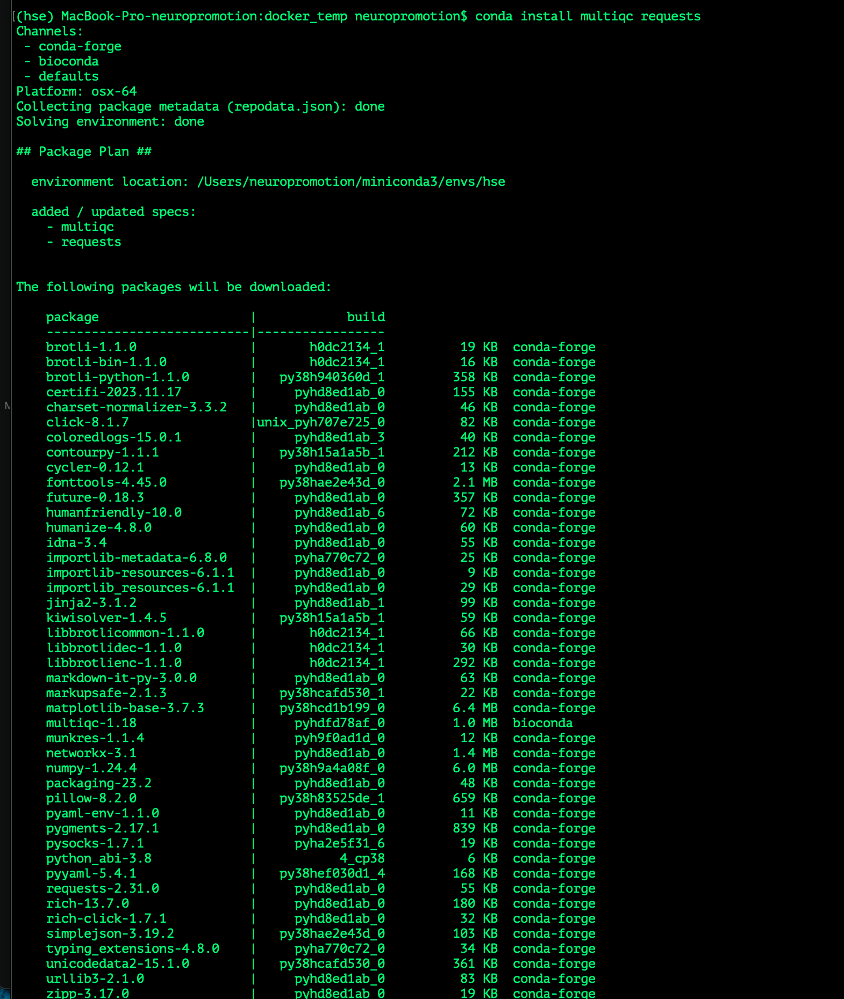

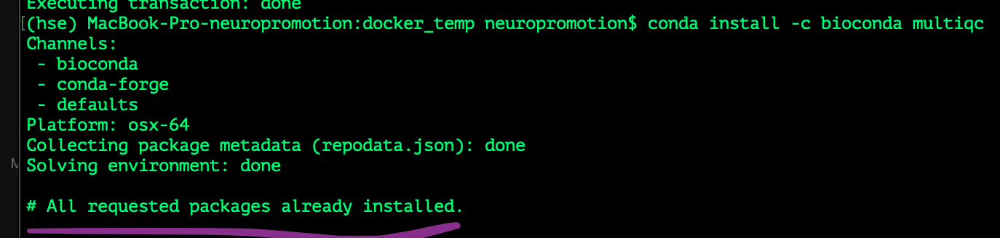

# используем fastqc для того что бы проанализовать данные секвенироваия генома чумной палочки. Для этого ппереходим в директорию где находится файл, создаем папку и применяем пакет к файлу

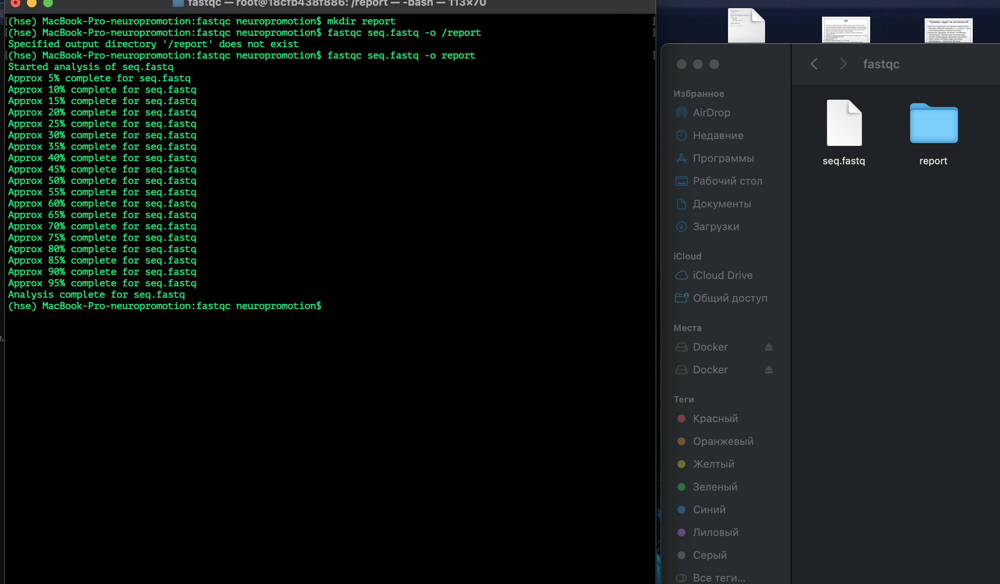

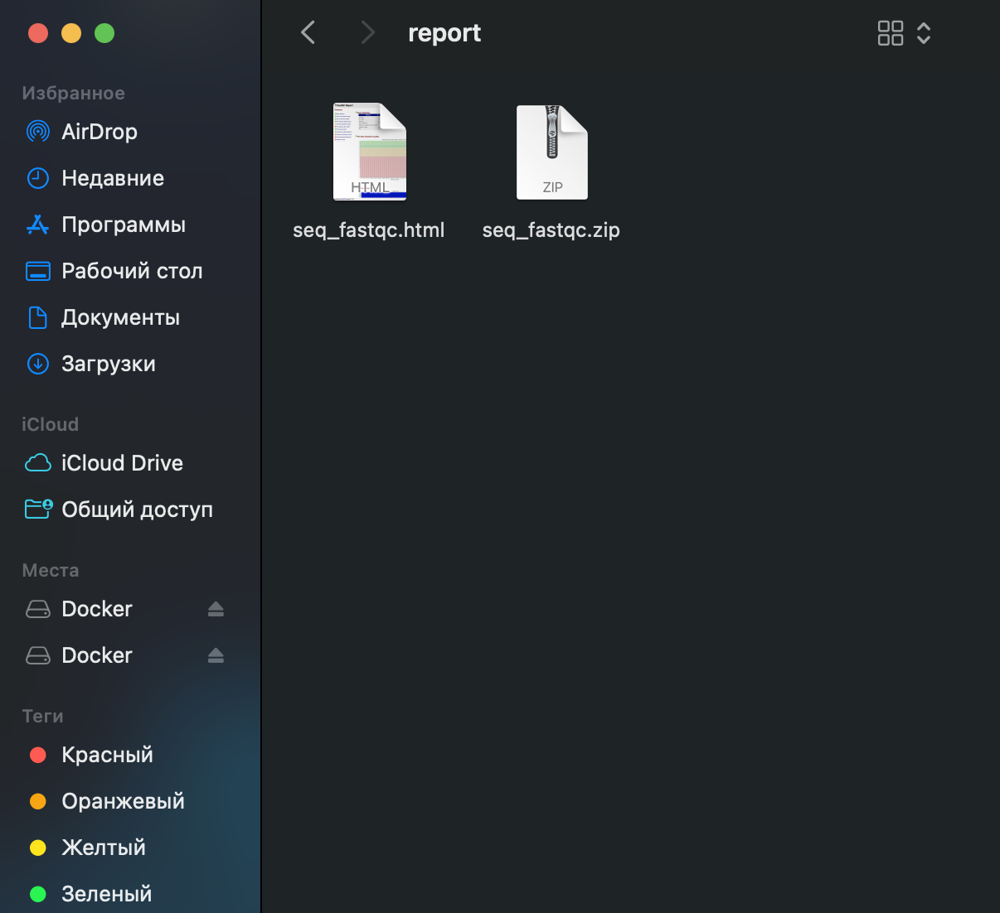

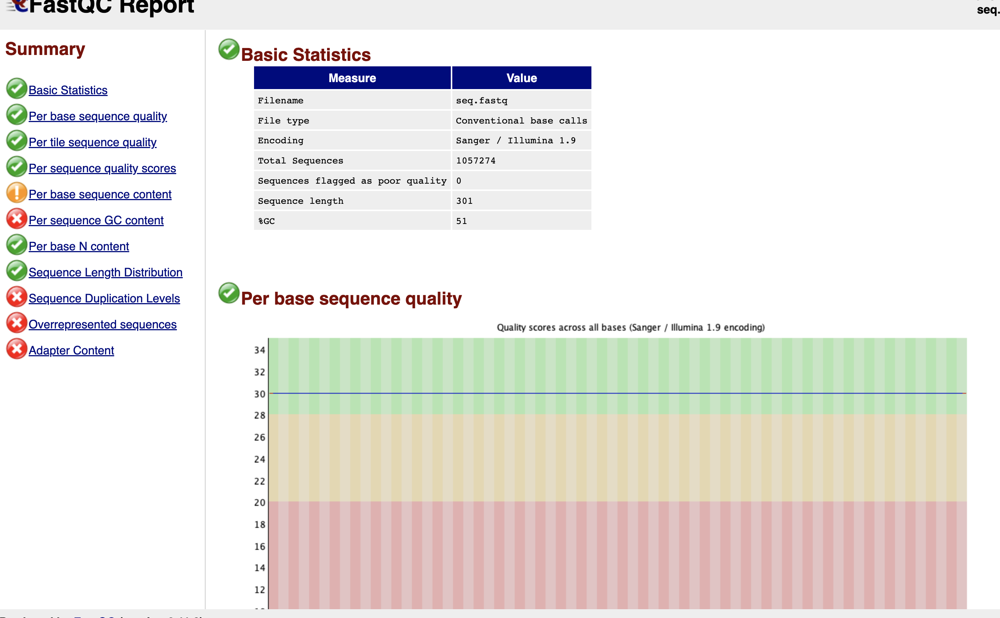

# сохраняеем окружение

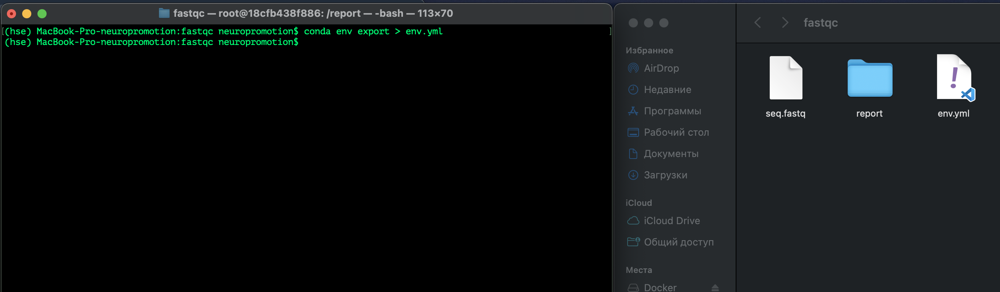

# далее создааем окружение из ямл файла:

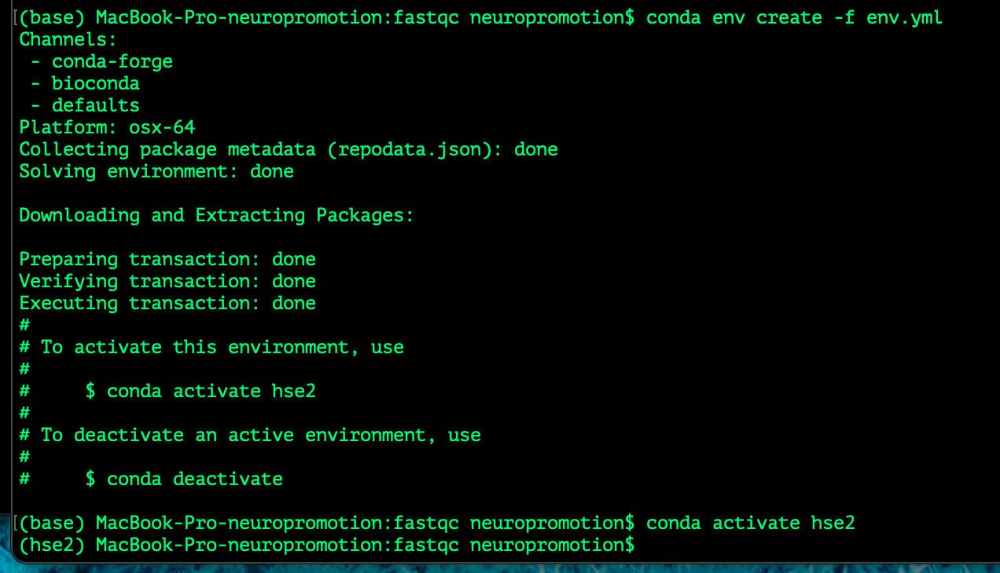

# DOCKERFILE не оптимизированный:

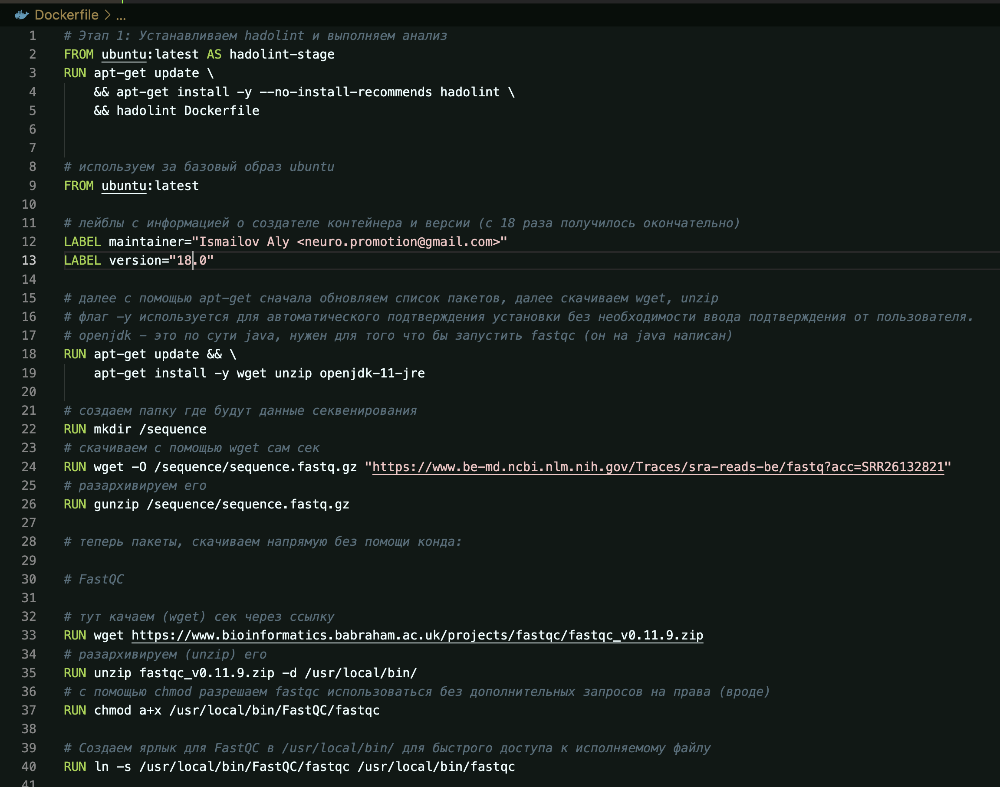

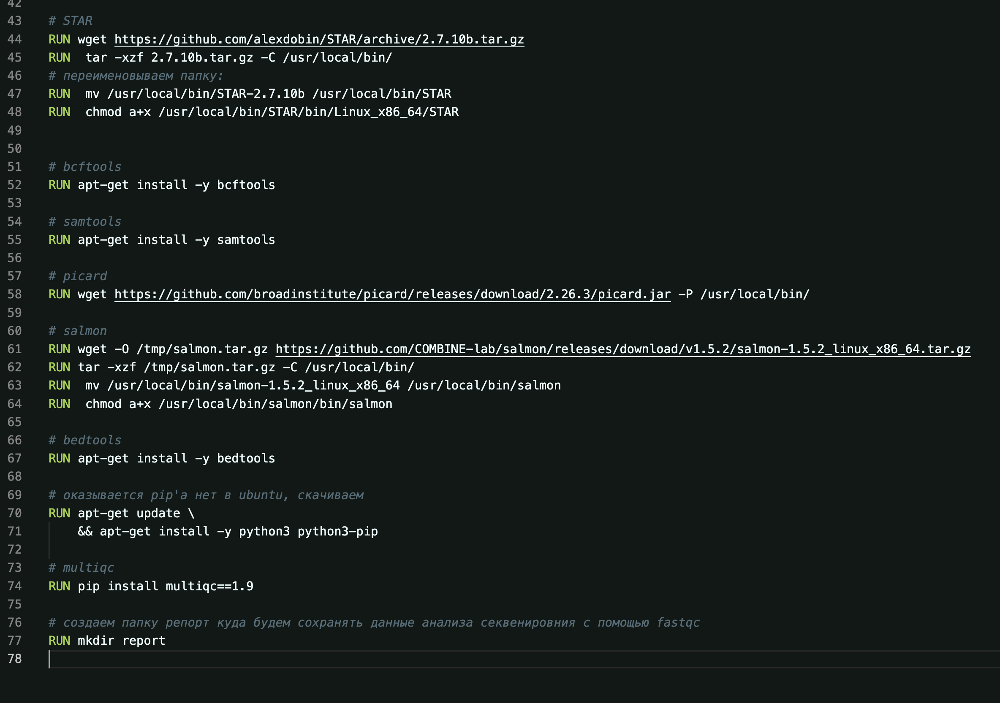

# с 18 раза получилось норм, так что версия 18

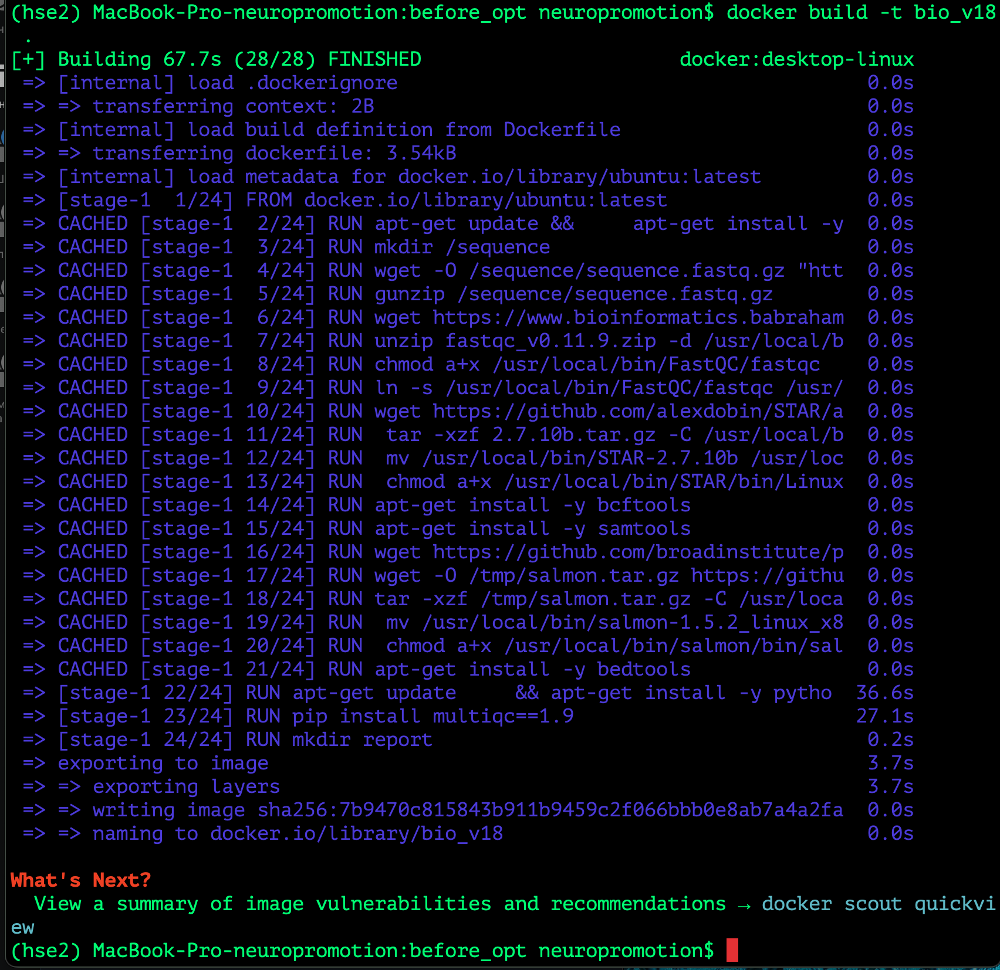

# Весит 2.92 гб

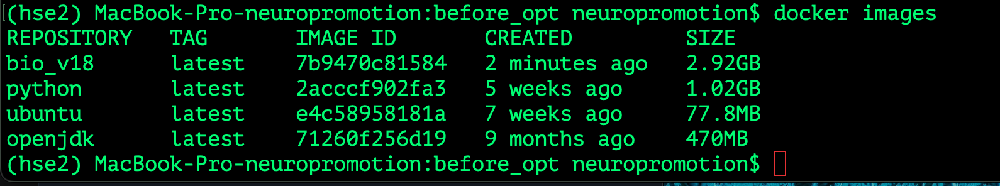

# создаем контейнер, проверяем наличие нужных папок, генерим html файл и переккидываем его в папку с докером

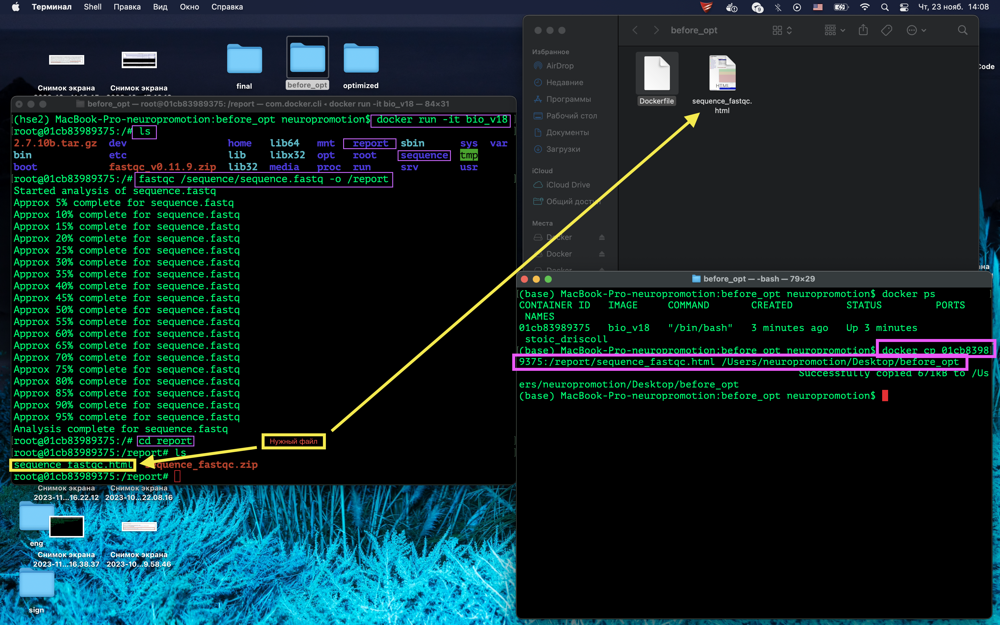

## Extra points [1.5]

You will be awarded extra points for the following:
* [1] Minimizing the size of the final Docker image. That is, removing all intermediates, unnecessary binaries/caches, etc. Don't forget to compare & report the final size before and after all the optimizations.

* [0.4] Create an extra Dockerfile that starts from [a conda base image](https://hub.docker.com/r/continuumio/anaconda3) and builds everything from your conda environment file.

Hint: `conda env create --quiet -f environment.yml && conda clean -a` ([example](https://github.com/nf-core/clipseq/blob/master/Dockerfile))

* [0.1] Share a meme about Docker or your impression of this assignment


# оптимизируем:

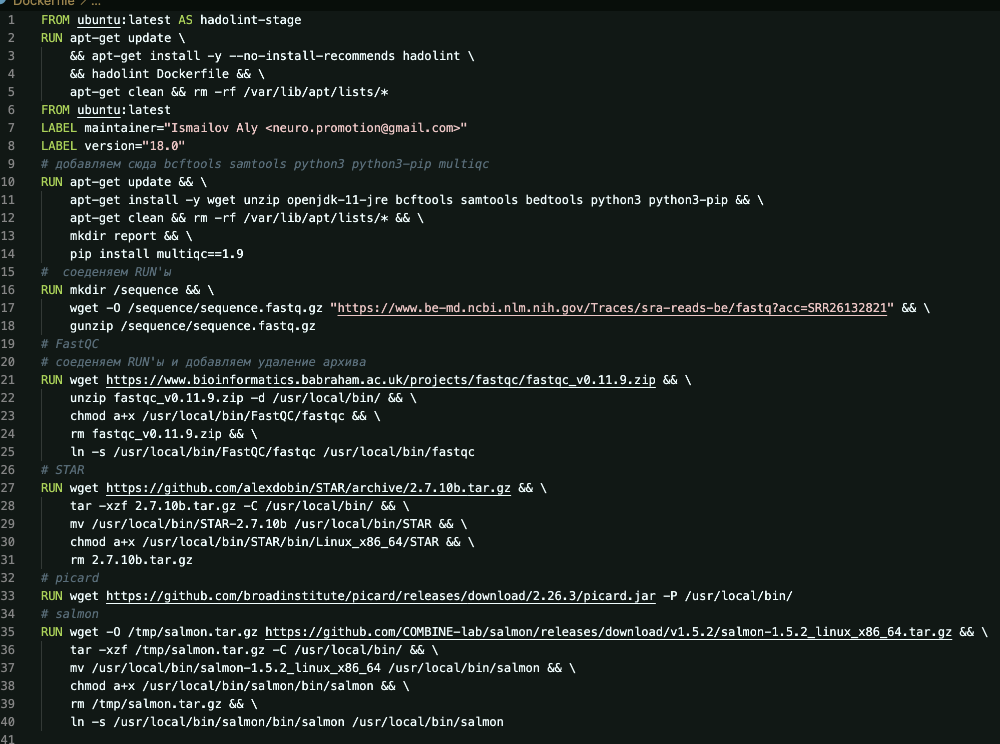

# разница в 720 мб

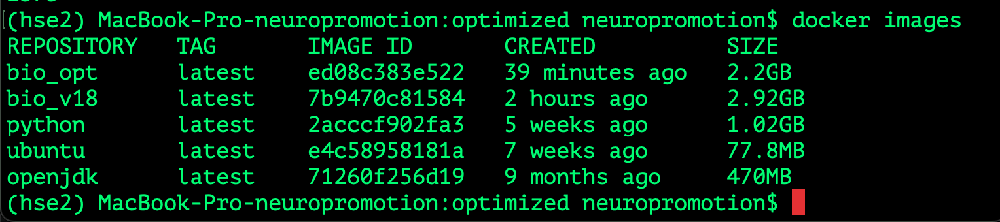

# теперь конда в контейнере:

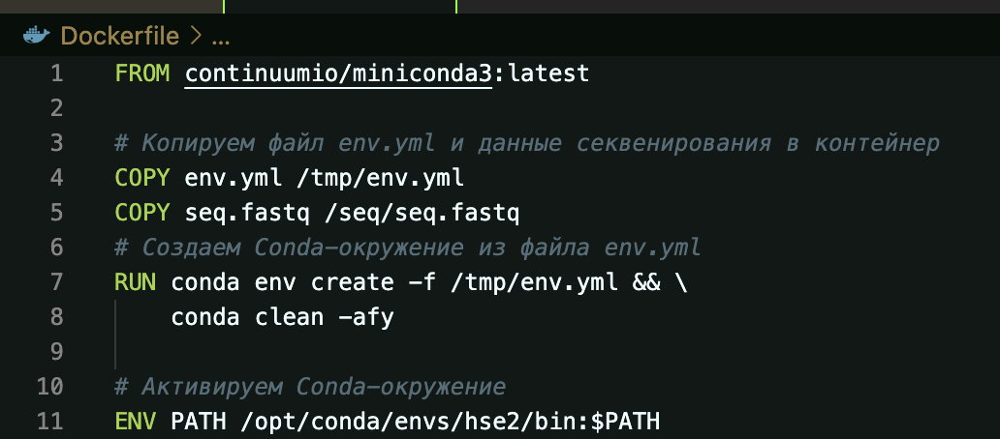

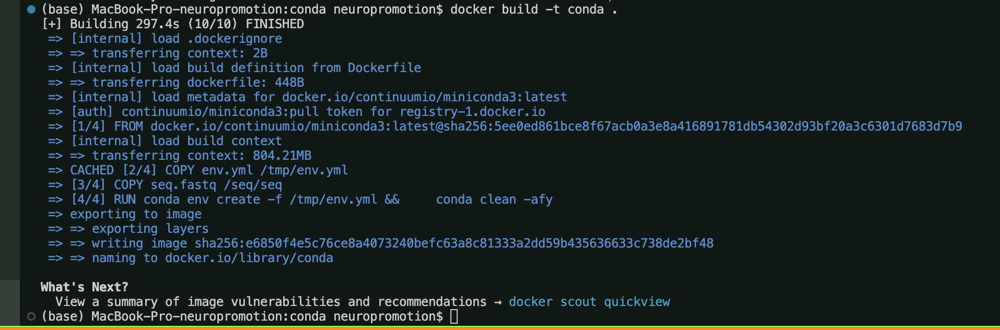

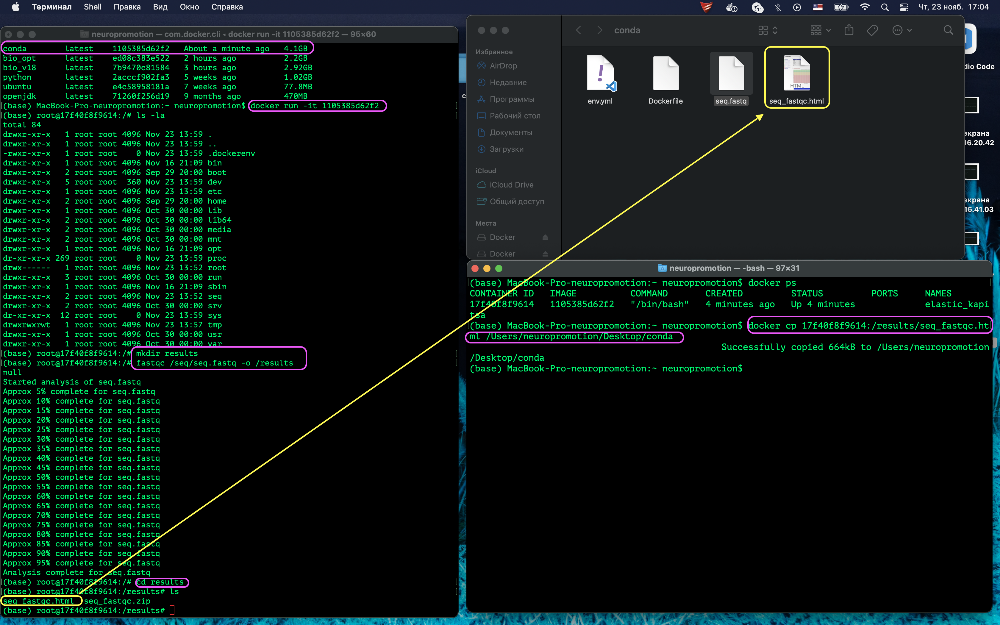

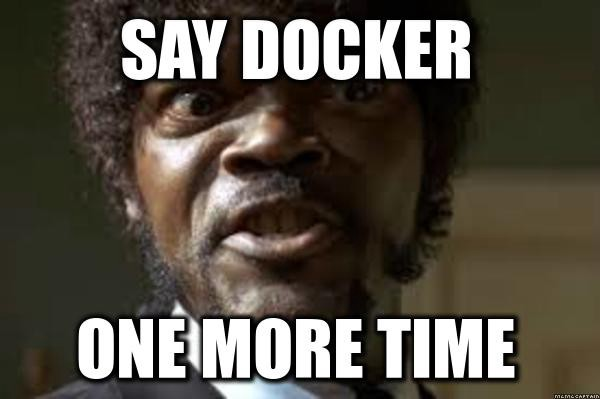

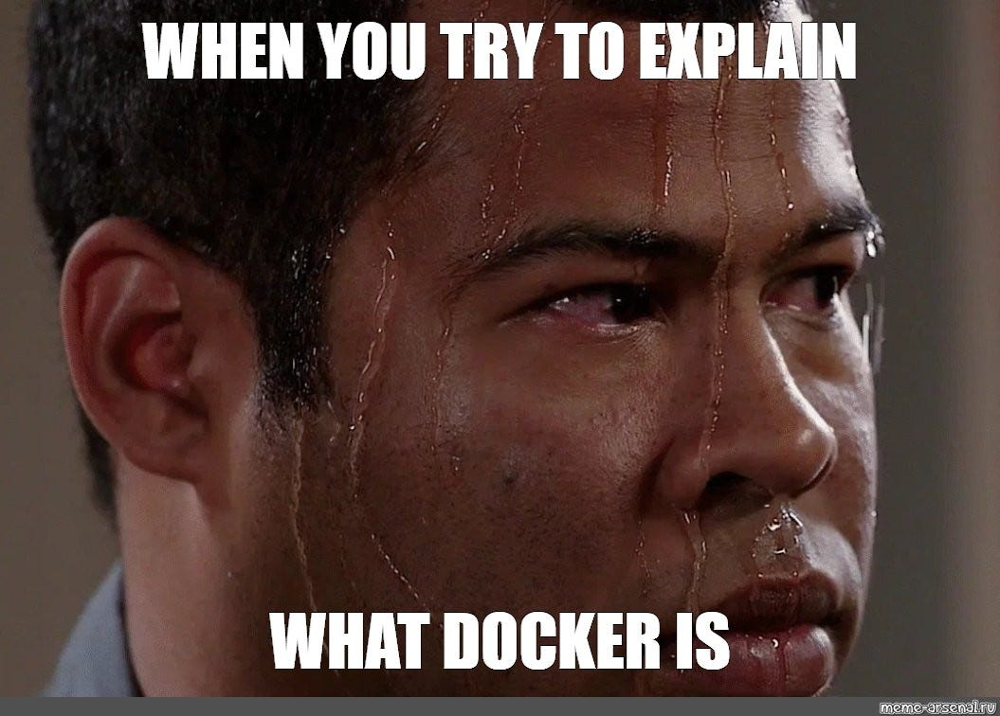